# **Load COCO Dataset**

In [3]:
!pip install pycocotools opencv-python albumentations tqdm 
!pip install torch torchvision torchaudio

In [5]:
# Downloaded COCO dataset from: http://cocodataset.org/#download
# Chose: 2017 Train images, 2017 Val images and corresponding annotations

import os

# Define paths for the COCO dataset
coco_train_img_dir = 'C:/Studies/3rd_sem_MS/Machine_Learning/Project/2_Data_Preparation/train2017/'
coco_val_img_dir = 'C:/Studies/3rd_sem_MS/Machine_Learning/Project/2_Data_Preparation/val2017/'
coco_train_annotations = 'C:/Studies/3rd_sem_MS/Machine_Learning/Project/2_Data_Preparation/annotations_trainval2017/instances_train2017.json'
coco_val_annotations = 'C:/Studies/3rd_sem_MS/Machine_Learning/Project/2_Data_Preparation/annotations_trainval2017/instances_val2017.json'

dataset_dir = 'dataset/'
os.makedirs(dataset_dir, exist_ok=True)

# **Convert COCO Annotations to YOLO Format**

In [6]:
from pycocotools.coco import COCO
import os
import cv2

# Create directories for YOLO annotations
train_label_dir = 'dataset/labels/train/'
val_label_dir = 'dataset/labels/val/'
os.makedirs(train_label_dir, exist_ok=True)
os.makedirs(val_label_dir, exist_ok=True)

def convert_coco_to_yolo(coco_json_path, img_dir, output_label_dir):
    coco = COCO(coco_json_path)
    
    # Iterate through all images in the dataset
    for img_id in coco.imgs:
        img_info = coco.loadImgs(img_id)[0]
        img_file = os.path.join(img_dir, img_info['file_name'])
        annotations = coco.loadAnns(coco.getAnnIds(imgIds=img_id))
        
        img_width, img_height = img_info['width'], img_info['height']
        label_file = os.path.join(output_label_dir, f"{img_info['file_name'][:-4]}.txt")
        
        with open(label_file, "w") as f:
            for ann in annotations:
                category_id = ann['category_id'] - 1  # Subtract 1 to make it zero-indexed
                bbox = ann['bbox']  # [x_min, y_min, width, height]
                x_center = (bbox[0] + bbox[2] / 2) / img_width
                y_center = (bbox[1] + bbox[3] / 2) / img_height
                width = bbox[2] / img_width
                height = bbox[3] / img_height
                
                # Write in YOLO format (class_id x_center y_center width height)
                f.write(f"{category_id} {x_center} {y_center} {width} {height}\n")

# Convert the train and validation datasets
convert_coco_to_yolo(coco_train_annotations, coco_train_img_dir, train_label_dir)
convert_coco_to_yolo(coco_val_annotations, coco_val_img_dir, val_label_dir)

print("Conversion completed. Labels saved in dataset/labels/train and dataset/labels/val.")

loading annotations into memory...
Done (t=7.42s)
creating index...
index created!
loading annotations into memory...
Done (t=0.30s)
creating index...
index created!
Conversion completed. Labels saved in dataset/labels/train and dataset/labels/val.


# **Split COCO Dataset Into Training and Validation Sets**

In [7]:
import shutil

# Directories for train and validation images in yolo target structure
train_img_dir = 'train/'
val_img_dir = 'dataset/images/val/'

# Create directories if they don't exist
os.makedirs(train_img_dir, exist_ok=True)
os.makedirs(val_img_dir, exist_ok=True)

# Move training images
for img in os.listdir(coco_train_img_dir):
    shutil.copy(os.path.join(coco_train_img_dir, img), os.path.join(train_img_dir, img))

# Move validation images
for img in os.listdir(coco_val_img_dir):
    shutil.copy(os.path.join(coco_val_img_dir, img), os.path.join(val_img_dir, img))

print("Completed")

Completed


# **Data Augmentation**

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2
import os
import shutil
import random

# Define augmentations
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.Resize(640, 640),  # Resize to 640x640
    ToTensorV2(),  # Convert to tensor
])

def augment_and_save_image(image_path, output_image_dir, output_label_dir, label_path=None):
    # Read the image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Failed to load image: {image_path}")
        return

    # Apply augmentation
    augmented = transform(image=image)['image']

    # Convert tensor back to NumPy array
    augmented = augmented.permute(1, 2, 0).numpy()  # From (C, H, W) to (H, W, C)
    augmented = (augmented * 255).astype('uint8')  # Scale back to 0-255

    # Invert colors
    augmented = 255 - augmented

    # Save augmented image
    file_name = os.path.basename(image_path)
    output_image_path = os.path.join(output_image_dir, f"aug_{file_name}")
    cv2.imwrite(output_image_path, augmented)

    # Copy the label file if it exists
    if label_path and os.path.exists(label_path):
        output_label_path = os.path.join(output_label_dir, f"aug_{os.path.basename(label_path)}")
        if not os.path.exists(output_label_path):  # Ensure label file is not copied twice
            shutil.copy(label_path, output_label_path)
    
    print(f"Augmented image saved to {output_image_path}")

# Augment images in the dataset directory
aug_label_dir = 'train/'  
output_image_dir = 'dataset/images/train/'  # Directory for augmented images
output_label_dir = 'dataset/labels/train/'  # Directory for augmented labels

os.makedirs(output_image_dir, exist_ok=True)
os.makedirs(output_label_dir, exist_ok=True)

for image_name in os.listdir(aug_label_dir):
    image_path = os.path.join(aug_label_dir, image_name)
    label_path = os.path.join(output_label_dir, image_name.replace('.jpg', '.txt'))
    augment_and_save_image(image_path, output_image_dir, output_label_dir, label_path)

print("Data Augmentation Completed")


Augmented image saved to dataset/images/train/aug_000000000009.jpg
Augmented image saved to dataset/images/train/aug_000000000025.jpg
Augmented image saved to dataset/images/train/aug_000000000030.jpg
Augmented image saved to dataset/images/train/aug_000000000034.jpg
Augmented image saved to dataset/images/train/aug_000000000036.jpg
Augmented image saved to dataset/images/train/aug_000000000042.jpg
Augmented image saved to dataset/images/train/aug_000000000049.jpg
Augmented image saved to dataset/images/train/aug_000000000061.jpg
Augmented image saved to dataset/images/train/aug_000000000064.jpg
Augmented image saved to dataset/images/train/aug_000000000071.jpg
Augmented image saved to dataset/images/train/aug_000000000072.jpg
Augmented image saved to dataset/images/train/aug_000000000073.jpg
Augmented image saved to dataset/images/train/aug_000000000074.jpg
Augmented image saved to dataset/images/train/aug_000000000077.jpg
Augmented image saved to dataset/images/train/aug_000000000078

# **Visualize Bounding Boxes**

In [ ]:
import cv2  # Import OpenCV for image handling
import matplotlib.pyplot as plt  # Import for visualization
import os

# Function to visualize YOLO bounding boxes
def visualize_yolo_bboxes(img_path, label_path):
    # Load the image
    img = cv2.imread(img_path)
    
    # Check if the image was loaded successfully
    if img is None:
        print(f"Failed to load image at {img_path}")
        return
    
    # Get image dimensions
    img_height, img_width = img.shape[:2]
    
    # Read the YOLO label file
    with open(label_path, "r") as f:
        labels = f.readlines()
    
    # Draw bounding boxes on the image
    for label in labels:
        class_id, x_center, y_center, width, height = map(float, label.split())
        
        # Convert YOLO format (normalized) to absolute pixel values
        x_center = int(x_center * img_width)
        y_center = int(y_center * img_height)
        width = int(width * img_width)
        height = int(height * img_height)
        
        # Calculate top-left corner
        top_left_x = int(x_center - width / 2)
        top_left_y = int(y_center - height / 2)
        
        # Draw the bounding box 
        img = cv2.rectangle(img, (top_left_x, top_left_y), 
                            (top_left_x + width, top_left_y + height), 
                            (255, 0, 0), 2)
    
    # Convert BGR (OpenCV default) to RGB for displaying in matplotlib
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Display the image with bounding boxes
    plt.imshow(img_rgb)
    plt.show()

# **Create data.yaml file for Training YOLO**

In [10]:
import os
import yaml

data_yaml_path = os.path.join(os.getcwd(), 'data.yaml')

# data.yaml content with 91 classes and indexed class names
data_yaml_content = {
    'train': 'C:/Users/iampr/Machine_Learning/dataset/images/train/',  # Path to training images
    'val': 'C:/Users/iampr/Machine_Learning/dataset/images/val/',      # Path to validation images

    # Number of classes
    'nc': 91,

    # Class names indexed from 0 to 90
    'names': {
        0: 'person',
        1: 'bicycle',
        2: 'car',
        3: 'motorbike',
        4: 'aeroplane',
        5: 'bus',
        6: 'train',
        7: 'truck',
        8: 'boat',
        9: 'trafficlight',
        10: 'firehydrant',
        11: 'streetsign',
        12: 'stopsign',
        13: 'parkingmeter',
        14: 'bench',
        15: 'bird',
        16: 'cat',
        17: 'dog',
        18: 'horse',
        19: 'sheep',
        20: 'cow',
        21: 'elephant',
        22: 'bear',
        23: 'zebra',
        24: 'giraffe',
        25: 'hat',
        26: 'backpack',
        27: 'umbrella',
        28: 'shoe',
        29: 'eyeglasses',
        30: 'handbag',
        31: 'tie',
        32: 'suitcase',
        33: 'frisbee',
        34: 'skis',
        35: 'snowboard',
        36: 'sportsball',
        37: 'kite',
        38: 'baseballbat',
        39: 'baseballglove',
        40: 'skateboard',
        41: 'surfboard',
        42: 'tennisracket',
        43: 'bottle',
        44: 'plate',
        45: 'wineglass',
        46: 'cup',
        47: 'fork',
        48: 'knife',
        49: 'spoon',
        50: 'bowl',
        51: 'banana',
        52: 'apple',
        53: 'sandwich',
        54: 'orange',
        55: 'broccoli',
        56: 'carrot',
        57: 'hotdog',
        58: 'pizza',
        59: 'donut',
        60: 'cake',
        61: 'chair',
        62: 'sofa',
        63: 'pottedplant',
        64: 'bed',
        65: 'mirror',
        66: 'diningtable',
        67: 'window',
        68: 'desk',
        69: 'toilet',
        70: 'door',
        71: 'tvmonitor',
        72: 'laptop',
        73: 'mouse',
        74: 'remote',
        75: 'keyboard',
        76: 'cellphone',
        77: 'microwave',
        78: 'oven',
        79: 'toaster',
        80: 'sink',
        81: 'refrigerator',
        82: 'blender',
        83: 'book',
        84: 'clock',
        85: 'vase',
        86: 'scissors',
        87: 'teddybear',
        88: 'hairdrier',
        89: 'toothbrush',
        90: 'hairbrush'
    }
}

# Writing the dictionary to data.yaml
with open(data_yaml_path, 'w') as file:
    yaml.dump(data_yaml_content, file, default_flow_style=False)

print("data.yaml file created")


data.yaml file created


# **Set Up YOLOv5 for Training**

In [11]:
# Clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...


In [7]:
#Change directory to YOLOv5
%cd yolov5
# Install dependencies
!pip install -r requirements.txt


[WinError 2] The system cannot find the file specified: 'yolov5'
C:\Users\iampr\Machine_Learning\yolov5


C:\Users\iampr\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\IPython\core\magics\osm.py:393: UserWarning: This is now an optional IPython functionality, using bookmarks requires you to install the `pickleshare` library.
  bkms = self.shell.db.get('bookmarks', {})


# **Train the YOLOv5 Model**

In [1]:
# Change directory to YOLOv5
%cd yolov5

C:\Users\iampr\Machine_Learning\yolov5


C:\Users\iampr\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\IPython\core\magics\osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [2]:
import os
os.environ['KMP_DUPLICATE_LIB_OK'] = 'TRUE'


In [3]:
!python train.py --img 640 --batch 16 --epochs 10 --data ../data.yaml --weights yolov5m.pt --project runs/train --name exp --device 0

print("Completed")

Completed


train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data\hyps\hyp.scratch-low.yaml, epochs=10, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data\hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=0, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest, ndjson_console=False, ndjson_file=False
github:  YOLOv5 is out of date by 5 commits. Use 'git pull' or 'git clone https://github.com/ultralytics/yolov5' to update.
YOLOv5  v7.0-378-g2f74455a Python-3.12.4 torch-2.5.0+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epo

# **Detect Objects in Image and Display Output**

In [2]:

!python detect.py --weights runs/train/exp32/weights/best.pt --img 640 --conf 0.25 --source ../indoor.jpg --data ../data.yaml


detect: weights=['runs/train/exp32/weights/best.pt'], source=../indoor.jpg, data=../data.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  v7.0-378-g2f74455a Python-3.12.4 torch-2.5.0+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)

Fusing layers... 
Model summary: 212 layers, 21216624 parameters, 0 gradients, 49.0 GFLOPs
image 1/1 C:\Users\iampr\Machine_Learning\indoor.jpg: 416x640 1 person, 1 cup, 2 pottedplants, 1 laptop, 1 clock, 1 vase, 84.0ms
Speed: 0.0ms pre-process, 84.0ms inference, 217.6ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs\detect\exp25


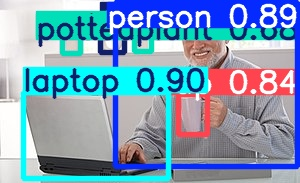

In [6]:
import os
from IPython.display import Image, display

# List all directories in 'runs/detect' that start with 'exp'
exp_dirs = [d for d in os.listdir('runs/detect') if d.startswith('exp')]

# Sort directories to find the latest one
def exp_key(name):
    if name == 'exp':
        return 0
    else:
        return int(name.replace('exp', ''))

latest_exp = sorted(exp_dirs, key=exp_key)[-1]

# Construct the path to the output image
output_image_path = f'runs/detect/{latest_exp}/indoor.jpg'

# Display the image
display(Image(filename=output_image_path, width=600))


# **Monitor Training Progress**

In [4]:
# Load TensorBoard extension
%load_ext tensorboard

# Start TensorBoard
%tensorboard --logdir runs/train --port 6006

Reusing TensorBoard on port 6006 (pid 18244), started 1 day, 15:28:26 ago. (Use '!kill 18244' to kill it.)

In [21]:
import torch
print("CUDA Available:", torch.cuda.is_available())
print("Device Name:", torch.cuda.get_device_name(0))


CUDA Available: True
Device Name: NVIDIA GeForce RTX 4060 Laptop GPU


In [3]:

!python detect.py --weights runs/train/exp32/weights/best.pt --img 640 --conf 0.25 --source ../outdoor.jpg --data ../data.yaml


detect: weights=['runs/train/exp32/weights/best.pt'], source=../outdoor.jpg, data=../data.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  v7.0-378-g2f74455a Python-3.12.4 torch-2.5.0+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)

Fusing layers... 
Model summary: 212 layers, 21216624 parameters, 0 gradients, 49.0 GFLOPs
image 1/1 C:\Users\iampr\Machine_Learning\outdoor.jpg: 416x640 2 persons, 1 bicycle, 1 car, 26.9ms
Speed: 0.0ms pre-process, 26.9ms inference, 101.6ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs\detect\exp23


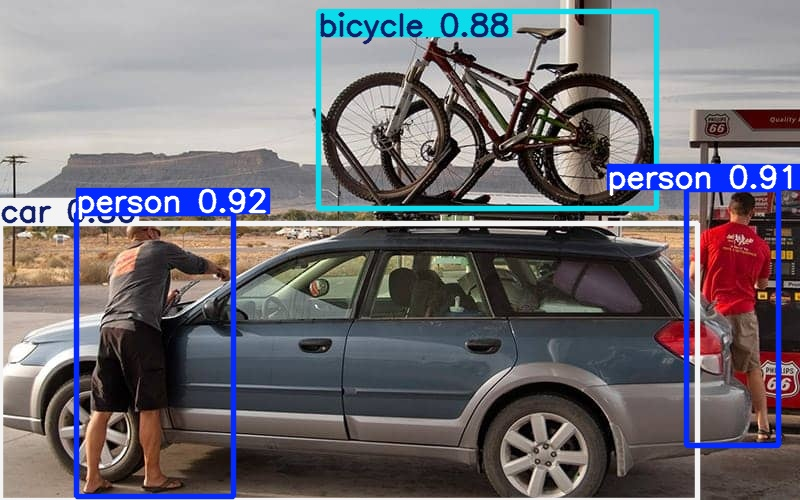

In [4]:
import os
from IPython.display import Image, display

# List all directories in 'runs/detect' that start with 'exp'
exp_dirs = [d for d in os.listdir('runs/detect') if d.startswith('exp')]

# Sort directories to find the latest one
def exp_key(name):
    if name == 'exp':
        return 0
    else:
        return int(name.replace('exp', ''))

latest_exp = sorted(exp_dirs, key=exp_key)[-1]

# Construct the path to the output image
output_image_path = f'runs/detect/{latest_exp}/outdoor.jpg'

# Display the image
display(Image(filename=output_image_path, width=600))
